In [36]:
#import packages for exploratory data analysis 
import pandas as pd
import numpy as np
from numpy.random import seed
from numpy.random import randn
from numpy import percentile
import matplotlib.pyplot as plt
import scipy.stats
import statsmodels.stats.power as smp
import numbers
import plotly
import plotly.graph_objs as go
from plotly.offline import init_notebook_mode, iplot
import chart_studio.plotly as py
import seaborn as sns
import folium 
from statannot import add_stat_annotation
from wordcloud import WordCloud, STOPWORDS

#import ML related packages
import pandas_profiling as pp
from pandas_profiling import ProfileReport
from sklearn.preprocessing import LabelEncoder
from sklearn.model_selection import train_test_split
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import precision_score
from sklearn import datasets, linear_model
from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeRegressor 
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import f_regression
from sklearn.metrics import mean_absolute_error

#silence pandas warnings
import warnings
warnings.filterwarnings('ignore')

In [2]:
#load dataset and inspect data
data=pd.read_csv("absenteeism.csv",delimiter=';')
data

,ID,Reason for absence,Month of absence,Day of the week,Seasons,Transportation expense,Distance from Residence to Work,Service time,Age,Work load Average/day,...,Disciplinary failure,Education,Son,Social drinker,Social smoker,Pet,Weight,Height,Body mass index,Absenteeism time in hours
0,11,26,7,3,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,4
1,36,0,7,3,1,118,13,18,50,239.554,...,1,1,1,1,0,0,98,178,31,0
2,3,23,7,4,1,179,51,18,38,239.554,...,0,1,0,1,0,0,89,170,31,2
3,7,7,7,5,1,279,5,14,39,239.554,...,0,1,2,1,1,0,68,168,24,4
4,11,23,7,5,1,289,36,13,33,239.554,...,0,1,2,1,0,1,90,172,30,2
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
735,11,14,7,3,1,289,36,13,33,264.604,...,0,1,2,1,0,1,90,172,30,8
736,1,11,7,3,1,235,11,14,37,264.604,...,0,3,1,0,0,1,88,172,29,4
737,4,0,0,3,1,118,14,13,40,271.219,...,0,1,1,1,0,8,98,170,34,0
738,8,0,0,4,2,231,35,14,39,271.219,...,0,1,2,1,0,2,100,170,35,0


In [3]:
#data preprocessing- checking to see what needs to be cleaned
#overview of dataset
data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 740 entries, 0 to 739
Data columns (total 21 columns):
 #   Column                           Non-Null Count  Dtype  
---  ------                           --------------  -----  
 0   ID                               740 non-null    int64  
 1   Reason for absence               740 non-null    int64  
 2   Month of absence                 740 non-null    int64  
 3   Day of the week                  740 non-null    int64  
 4   Seasons                          740 non-null    int64  
 5   Transportation expense           740 non-null    int64  
 6   Distance from Residence to Work  740 non-null    int64  
 7   Service time                     740 non-null    int64  
 8   Age                              740 non-null    int64  
 9   Work load Average/day            740 non-null    float64
 10  Hit target                       740 non-null    int64  
 11  Disciplinary failure             740 non-null    int64  
 12  Education             

In [4]:
#check for missing values
data.isnull().sum()

ID                                 0
Reason for absence                 0
Month of absence                   0
Day of the week                    0
Seasons                            0
Transportation expense             0
Distance from Residence to Work    0
Service time                       0
Age                                0
Work load Average/day              0
Hit target                         0
Disciplinary failure               0
Education                          0
Son                                0
Social drinker                     0
Social smoker                      0
Pet                                0
Weight                             0
Height                             0
Body mass index                    0
Absenteeism time in hours          0
dtype: int64

In [5]:
#deeper inspection of dataframe using pandas profiling
profile = pp.ProfileReport(data, title = "profile report-absenteeism")
profile

Summarize dataset:   0%|          | 0/34 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [6]:
#replace 0 values in month of absence with unknown
data['Month of absence'] = data['Month of absence'].replace(['0'],'unknown')

In [7]:
#create a new dataframe grouped by ID number so that we can look at the total amount of time absent taken by each individual and their profile
df=data.groupby(['ID','Body mass index','Education','Distance from Residence to Work','Age'])['Absenteeism time in hours'].sum().to_frame(name='Absenteeism time in hours').reset_index()
df.head()

,ID,Body mass index,Education,Distance from Residence to Work,Age,Absenteeism time in hours
0,1,29,3,11,37,121
1,2,33,1,29,48,25
2,3,31,1,51,38,482
3,4,34,1,14,40,0
4,5,38,1,20,43,104


<AxesSubplot:>

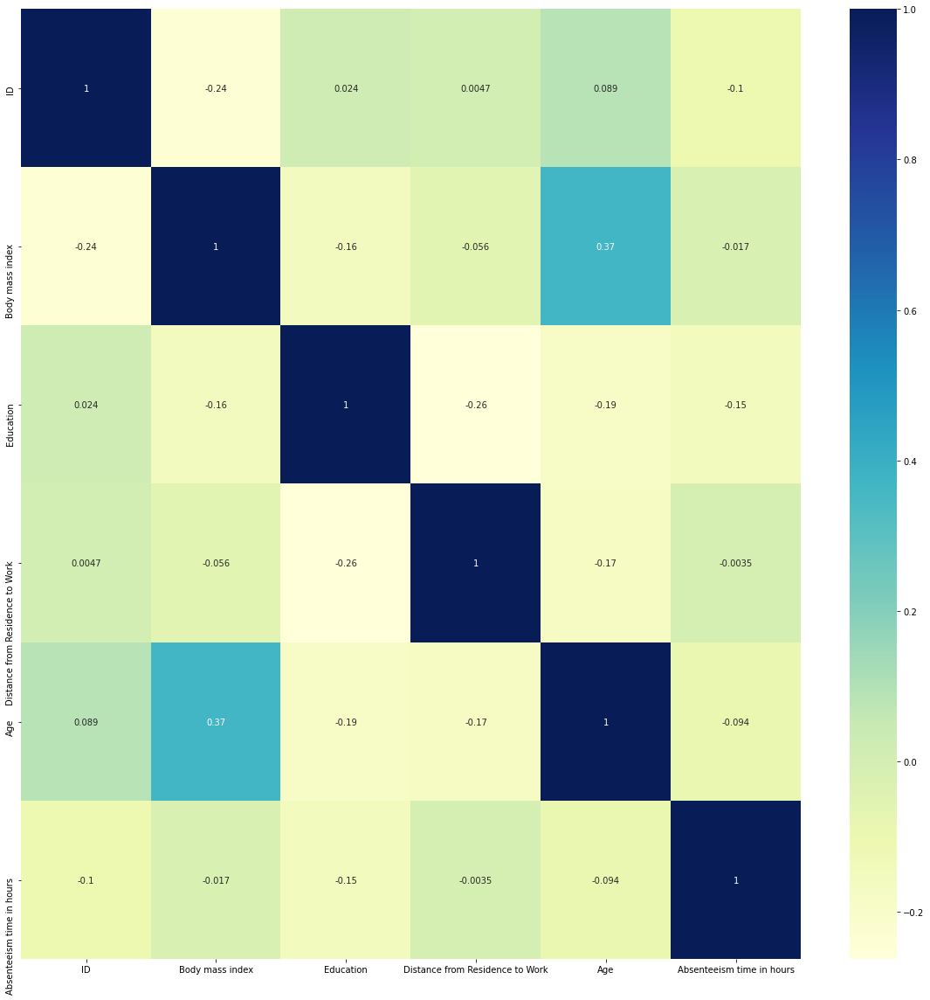

In [8]:
#explore correlation between the different variables using heatmap
fig, ax = plt.subplots(figsize=(20, 20)) 
sns.heatmap(df.corr(), annot = True, ax = ax,cmap="YlGnBu")

In [9]:
"""
create new column to Include BMI categories for easy visualization:
underweight (under 18.5)
normal weight (18.5 to 25)
overweight (25 to 30)
obese (over 30)
"""

col         = 'Body mass index'
conditions  = [ df[col] < 18.5, (df[col] < 25) & (df[col]>= 18.5),(df[col] >=25) & (df[col]<30), df[col] >=30 ]
categories     = [ "underweight", 'normal weight', 'overweight','obese' ]
    
df["BMI"] = np.select(conditions, categories, default=np.nan)


In [10]:
"""
create new column for age group description (age range of sample is 27-58 based on profile report):

20-39:young adult
40-59:middle age


"""

col         = 'Age'
conditions  = [(df[col] > 20) & (df[col]<= 39),(df[col] >=40) & (df[col]<=59) ]
categories     = [ "young adult", "middle age" ]
    
df["age group"] = np.select(conditions, categories, default=np.nan)


In [11]:
#rename columns to make it more readable/user friendly
df=df.rename(columns={"Distance from Residence to Work": "Distance from Residence to Work (km)"})
df=df.rename(columns={"Absenteeism time in hours": "Time absent (hrs)"})
df.head()

,ID,Body mass index,Education,Distance from Residence to Work (km),Age,Time absent (hrs),BMI,age group
0,1,29,3,11,37,121,overweight,young adult
1,2,33,1,29,48,25,obese,middle age
2,3,31,1,51,38,482,obese,young adult
3,4,34,1,14,40,0,obese,middle age
4,5,38,1,20,43,104,obese,middle age


p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

normal weight v.s. overweight: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=9.300e+01
overweight v.s. obese: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=6.700e+01
normal weight v.s. obese: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=1.000e+00 U_stat=6.250e+01


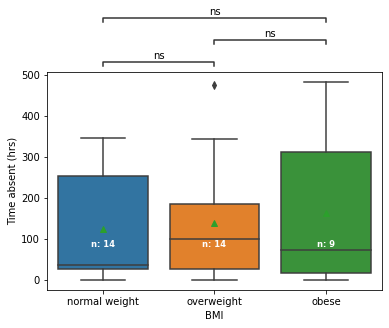

In [12]:
#plot a barplot to show relationship between BMI and time absent 
x = "BMI"
y = "Time absent (hrs)"
order = ['normal weight', 'overweight','obese']
BMI_absence = sns.boxplot(data=df, x=x, y=y, order=order,showmeans=True)
#adding in statistical notation to denote sig level
add_stat_annotation(BMI_absence, data=df, x=x, y=y, order=order,
                    box_pairs=[("normal weight", "overweight"), ("overweight", "obese"), ("obese", "normal weight")],
                    test='Mann-Whitney', text_format='star', loc='outside', verbose=2)



#add number of oberservations for each group
nobs = df['BMI'].value_counts().values
nobs = [str(x) for x in nobs.tolist()]
nobs = ["n: " + i for i in nobs]
pos = range(len(nobs))
for tick,label in zip(pos,BMI_absence.get_xticklabels()):
    BMI_absence.text(pos[tick],
           80,
            nobs[tick],
            horizontalalignment='center',
            size='small',
            color='w',
            weight='semibold')
    
plt.show()



<AxesSubplot:xlabel='Distance from Residence to Work (km)', ylabel='Time absent (hrs)'>

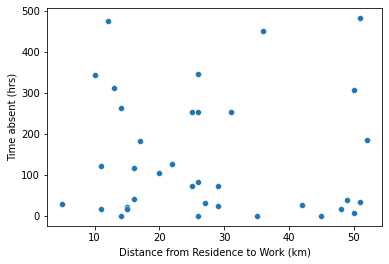

In [13]:
#plot a scatterplot to determine if there is a correlation between distance from residence to work and time absent

sns.scatterplot(data=df, x="Distance from Residence to Work (km)", y="Time absent (hrs)")

#from the graph it appears that there is no correlation.

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

young adult v.s. middle age: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=2.995e-01 U_stat=1.990e+02


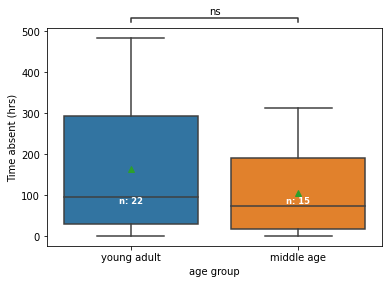

In [14]:
#let's look at whether there are any difference in time absent between the two age groups i.e. young adult and middle age 
#plot a boxplot with outliers removed
x = "age group"
y = "Time absent (hrs)"
order = ['young adult', 'middle age']
age_absence = sns.boxplot(data=df, x=x, y=y, order=order,showmeans=True,showfliers=False)
#adding in statistical notation to denote sig level
add_stat_annotation(age_absence, data=df, x=x, y=y, order=order,
                    box_pairs=[("young adult", "middle age")],
                    test='Mann-Whitney', text_format='star', loc='outside', verbose=2)


#add number of oberservations for each group
nobs = df['age group'].value_counts().values
nobs = [str(x) for x in nobs.tolist()]
nobs = ["n: " + i for i in nobs]
pos = range(len(nobs))
for tick,label in zip(pos,age_absence.get_xticklabels()):
    age_absence.text(pos[tick],
           80,
            nobs[tick],
            horizontalalignment='center',
            size='small',
            color='w',
            weight='semibold')
    
plt.show()

#there is a difference in means between the two groups but this difference is not statistically significant 

In [40]:
#do power analysis to get a sense of sample size needed for future studies in order to achieve statistical power
#effect size assuming two different groups 
power_analysis = smp.TTestIndPower()
sample_size = power_analysis.solve_power(effect_size=0.5, power=0.8, alpha=0.05)
sample_size

"""the minimum size of each group in order to achieve see any significant difference 
between two groups appears to be around 64"""

'the minimum size of each group in order to achieve see any significant difference \nbetween two groups appears to be around 64'

In [15]:
#Let's now look at the data at the record- level (as opposed to consolidated records for each individual employee )
#create a new dataframe to do focused analysis on possible correlations between reasons for absence with other variables

df_absence=data[['Reason for absence','Absenteeism time in hours','Day of the week','Body mass index']]

"""
create new column to Include BMI categories for easy visualization:
underweight (under 18.5)
normal weight (18.5 to 25)
overweight (25 to 30)
obese (over 30)
"""

col         = 'Body mass index'
conditions  = [ df_absence[col] < 18.5, (df_absence[col] < 25) & (df_absence[col]>= 18.5),(df_absence[col] >=25) & (df_absence[col]<30), df_absence[col] >=30 ]
categories     = [ "underweight", 'normal weight', 'overweight','obese' ]
    
df_absence["BMI"] = np.select(conditions, categories, default=np.nan)

#rename absenteeism time in hours to time absent for consistency 
df_absence=df_absence.rename(columns={"Absenteeism time in hours": "Time absent (hrs)"})

df_absence.head()


,Reason for absence,Time absent (hrs),Day of the week,Body mass index,BMI
0,26,4,3,30,obese
1,0,0,3,31,obese
2,23,2,4,31,obese
3,7,4,5,24,normal weight
4,23,2,5,30,obese


In [16]:
#do a quick count to see most common reasons for absence 
df_absence['Reason for absence'].value_counts()



23    149
28    112
27     69
13     55
0      43
19     40
22     38
26     33
25     31
11     26
10     25
18     21
14     19
1      16
7      15
12      8
6       8
8       6
21      6
9       4
24      3
5       3
16      3
15      2
4       2
3       1
17      1
2       1
Name: Reason for absence, dtype: int64

In [17]:
#to focus our analysis, let's zoom in on the top 11 reasons (natural cut off), and drop the rest
to_drop=[18,14,1,7,12,6,8,21,9,24,5,16,15,4,3,17,2]
df_absence = df_absence[~df_absence['Reason for absence'].isin(to_drop)]



In [18]:
#replace numerical code for reasons for absence with their string names


replace_values = {23: "medical consultation", 28:"dental consultation" , 27 :"physiotherapy",13:"musculoskeletal diseases",0:"unknown",19:"Injury, poisoning",22: "patient follow-up ",26:"unjustified absence",25:"lab examination",11:"digestive issues",10:"respiratory diseases"}                                                                                          

df_absence = df_absence.replace({"Reason for absence": replace_values}) 

#check dataframe
df_absence

,Reason for absence,Time absent (hrs),Day of the week,Body mass index,BMI
0,unjustified absence,4,3,30,obese
1,unknown,0,3,31,obese
2,medical consultation,2,4,31,obese
4,medical consultation,2,5,30,obese
5,medical consultation,2,6,31,obese
...,...,...,...,...,...
734,musculoskeletal diseases,80,2,25,overweight
736,digestive issues,4,3,29,overweight
737,unknown,0,3,34,obese
738,unknown,0,4,35,obese


In [19]:
#replace days key with string for easy visualization---Day of the week (Monday (2), Tuesday (3), Wednesday (4), Thursday (5), Friday (6))
replace_values = {2: "Mon", 3:"Tues" ,4 :"Weds",5:"Thurs",6:"Fri"}                                                                                          

df_absence= df_absence.replace({"Day of the week": replace_values}) 
df_absence.head()

,Reason for absence,Time absent (hrs),Day of the week,Body mass index,BMI
0,unjustified absence,4,Tues,30,obese
1,unknown,0,Tues,31,obese
2,medical consultation,2,Weds,31,obese
4,medical consultation,2,Thurs,30,obese
5,medical consultation,2,Fri,31,obese


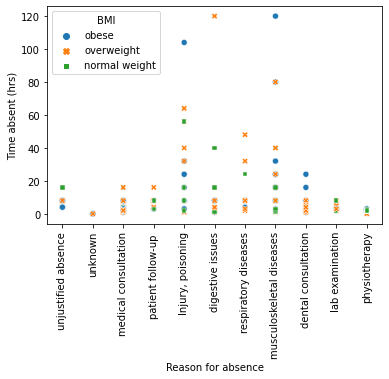

In [20]:
#create scatter plot to show relationship between top reasons for absence, time absent and BMI
plot_absence=sns.scatterplot(data=df_absence, x="Reason for absence", y="Time absent (hrs)", hue="BMI", style="BMI")


for item in plot_absence.get_xticklabels():
    item.set_rotation(90)

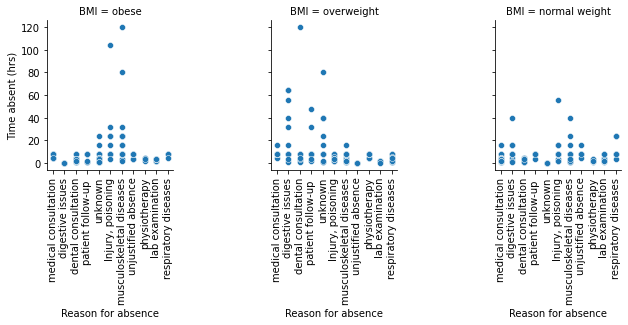

In [21]:
#let's take a closer look at the reasons for absence in each weight group
grid_plot = sns.FacetGrid(data=df_absence, col='BMI', col_wrap=4)
grid_plot.map(sns.scatterplot, 'Reason for absence', 'Time absent (hrs)')

#rotate x-labels
grid_plot.set_xticklabels(rotation=90)

p-value annotation legend:
ns: 5.00e-02 < p <= 1.00e+00
*: 1.00e-02 < p <= 5.00e-02
**: 1.00e-03 < p <= 1.00e-02
***: 1.00e-04 < p <= 1.00e-03
****: p <= 1.00e-04

Mon v.s. Tues: Mann-Whitney-Wilcoxon test two-sided with Bonferroni correction, P_val=3.182e-02 U_stat=9.366e+03


(<AxesSubplot:xlabel='Day of the week', ylabel='Time absent (hrs)'>,
 [<statannot.StatResult.StatResult at 0x7fa70efbe490>])

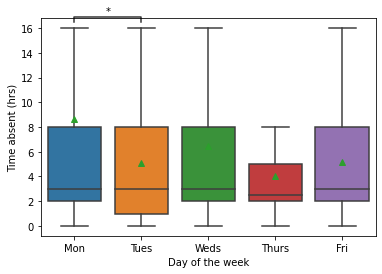

In [22]:
#let's look at whether time absent is greater for certain days of the week with outliers removed
x = "Day of the week"
y = "Time absent (hrs)"
order = ['Mon','Tues','Weds','Thurs','Fri']
Day_absence = sns.boxplot(data=df_absence, x=x, y=y, order=order,showmeans=True,showfliers=False)

add_stat_annotation(Day_absence, data=df_absence, x=x, y=y, order=order,
                    box_pairs=[("Mon", "Tues")],
                    test='Mann-Whitney', text_format='star', loc='outside', verbose=2)

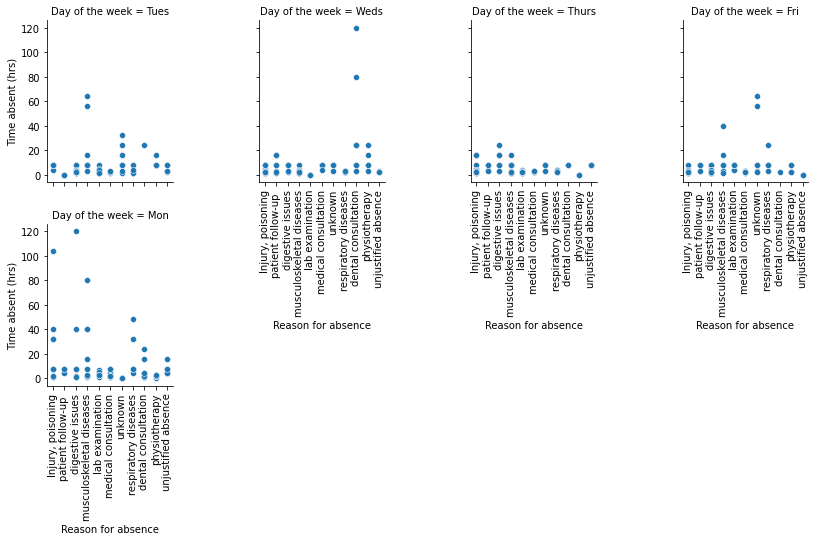

In [23]:
"""
Since Monday has the highest mean and median for time absent, let's look at the reasons for absenteeism 
to shed some light on why people are more likely to take more sick leave on Mondays

"""

#scatter plot of days of the week, reasons for absence and time absent 
grid_plot = sns.FacetGrid(data=df_absence, col='Day of the week', col_wrap=4)
grid_plot.map(sns.scatterplot, 'Reason for absence', 'Time absent (hrs)')

grid_plot.set_xticklabels(rotation=90)

## Training a Machine Learning model 
Now that we've done some preliminary data analysis and have a better sense of possible correlation among variables, let's train a machine learning model to predict abesenteeism 

In [24]:
#data pre-processing: addressing outliers
#identify outliers by using interquartile range method,  do a count and assess whether or not to remove

# seed the random number generator
seed(1)
# calculate interquartile range
q25, q75 = percentile(data['Absenteeism time in hours'], 25), percentile(data['Absenteeism time in hours'], 75)
iqr = q75 - q25
print('Percentiles: 25th=%.3f, 75th=%.3f, IQR=%.3f' % (q25, q75, iqr))
# calculate the outlier cutoff
cut_off = iqr * 1.5
lower, upper = q25 - cut_off, q75 + cut_off
# identify outliers
outliers = [x for x in data['Absenteeism time in hours'] if x < lower or x > upper]
print('Identified outliers: %d' % len(outliers))

print('% of data remaining if outliers are removed:',(len(data)-len(outliers))/len(data)*100)

"""Assessment: Since the outliers account for only about 6% of data and they are likely to represent real 
datapoints (e.g. taking extended time off because of critical illness), we should retain this data """

Percentiles: 25th=2.000, 75th=8.000, IQR=6.000
Identified outliers: 44
% of data remaining if outliers are removed: 94.05405405405406


'Assessment: Since the outliers account for only about 6% of data and they are likely to represent real \ndatapoints (e.g. taking extended time off because of critical illness), we should retain this data '

In [25]:
#drop unecessary columns
data=data.drop(columns=['ID'])

In [26]:
#split dataset into training and test sets using train-test-split
#separate features from target value 
X=data.drop('Absenteeism time in hours',axis=1)
Y=data['Absenteeism time in hours']
#perform a 80-20 split
X_new, X_test,Y_new, Y_test = train_test_split(X, Y, test_size=0.2, random_state = 0)
test_size = X_test.shape[0] / X_new.shape[0]
X_train, X_dev, Y_train, Y_dev = train_test_split(X_new, Y_new, test_size=test_size, random_state = 0)
print(X_train.shape,Y_train.shape,X_dev.shape,Y_dev.shape,X_test.shape,Y_test.shape)

(444, 19) (444,) (148, 19) (148,) (148, 19) (148,)


In [27]:
# Linear regression 
# Create linear regression object
regression_model = linear_model.LinearRegression()

# Train the model using the training set
regression_model.fit(X_train, Y_train)

# Make predictions using the test set
Y_pred = regression_model.predict(X_test)
Y_pred


array([-0.73651038, 12.69493719,  5.21239479,  2.45621452,  8.29556157,
        5.21897694,  7.64432477,  6.53645222,  3.13025344,  0.93910908,
        5.04373291,  6.18796042,  8.24637676,  4.29687929,  4.5741449 ,
        6.13113547,  2.18356408,  3.1612055 ,  5.36343638,  8.64446338,
       17.80815678, 15.77571486,  8.49988513,  7.23496565,  9.16854179,
       -2.56738703,  8.00053475, 18.93836755, 17.94659628,  2.76330257,
       22.69960206, -2.05721649,  8.48683495, 12.2076104 , 19.67611862,
        5.8386243 , 23.3350783 ,  6.43696781, 15.54766179, 22.14316417,
       -3.3049842 ,  9.03237986,  7.21282432, 13.40307864,  0.18623768,
        3.91554733,  2.42792839,  0.21722357,  1.2802481 , 26.50553479,
        7.4724653 ,  1.05791237,  6.67656925,  6.72686461,  6.82604421,
       17.12731326,  2.57009835, 13.18916146,  7.16678969, -0.95870988,
       14.56827856,  0.78771903, 10.28917911, -0.25836497,  0.56057384,
        8.80268106,  5.52233295,  5.91613905, 16.5906958 , -0.52

In [28]:
#let's now try a decision tree regressor 
dt = DecisionTreeRegressor()
dt.fit(X_train, Y_train)


DecisionTreeRegressor(criterion='mse', max_depth=None, max_features=None,
                      max_leaf_nodes=None, min_impurity_decrease=0.0,
                      min_impurity_split=None, min_samples_leaf=1,
                      min_samples_split=2, min_weight_fraction_leaf=0.0,
                      presort=False, random_state=None, splitter='best')

In [29]:
#Create a function to report errors
def report_error(model, X, Y, metric='mae'):
    """
    Reports the errors from model prediction.
    :param model: trained ml model
    :param X: dataset of features
    :param y: array of actual outcome values
    :param metric: mae - mean absolute, mad - median absolute, 
    :return: error value
    """

    predicted = model.predict(X)
    if metric == 'mae':
        errors = abs(predicted - Y)
        print(f'The mean absolute error is {np.mean(errors):0.2f}.')
        # return np.mean(errors)
    elif metric == 'mad':
        errors = abs(predicted - Y)
        print(f'The median absolute devation is {np.median(errors):0.2f}.')
        # return np.median(errors)

        
# Report the errors for decision tree regressor
report_error(dt, X_test, Y_test, 'mae')
report_error(dt, X_test, Y_test, 'mad')


The mean absolute error is 9.39.
The median absolute devation is 1.00.


In [30]:
# Report errors for linear regression model
report_error(regression_model, X_test, Y_test, 'mae')
report_error(regression_model, X_test, Y_test, 'mad')

The mean absolute error is 7.02.
The median absolute devation is 4.86.


In [31]:
#tune the models using feature selection 
# define feature selection function 
def select_features(X_train, Y_train, X_test):
    fs = SelectKBest(score_func=f_regression, k=10)
    fs.fit(X_train, Y_train)
    X_train_fs = fs.transform(X_train)
    X_test_fs = fs.transform(X_test)
    return X_train_fs, X_test_fs, fs 

In [32]:
# feature selection for train and test data
X_train_fs, X_test_fs, fs = select_features(X_train, Y_train, X_test)



In [33]:
# created linear regression model for selected features data
regression_model_fs = linear_model.LinearRegression()

# Train the model using the training sets
regression_model_fs.fit(X_train_fs, Y_train)

# Make predictions using the test set
Y_pred_fs = regression_model.predict(X_test)
Y_pred_fs




array([-0.73651038, 12.69493719,  5.21239479,  2.45621452,  8.29556157,
        5.21897694,  7.64432477,  6.53645222,  3.13025344,  0.93910908,
        5.04373291,  6.18796042,  8.24637676,  4.29687929,  4.5741449 ,
        6.13113547,  2.18356408,  3.1612055 ,  5.36343638,  8.64446338,
       17.80815678, 15.77571486,  8.49988513,  7.23496565,  9.16854179,
       -2.56738703,  8.00053475, 18.93836755, 17.94659628,  2.76330257,
       22.69960206, -2.05721649,  8.48683495, 12.2076104 , 19.67611862,
        5.8386243 , 23.3350783 ,  6.43696781, 15.54766179, 22.14316417,
       -3.3049842 ,  9.03237986,  7.21282432, 13.40307864,  0.18623768,
        3.91554733,  2.42792839,  0.21722357,  1.2802481 , 26.50553479,
        7.4724653 ,  1.05791237,  6.67656925,  6.72686461,  6.82604421,
       17.12731326,  2.57009835, 13.18916146,  7.16678969, -0.95870988,
       14.56827856,  0.78771903, 10.28917911, -0.25836497,  0.56057384,
        8.80268106,  5.52233295,  5.91613905, 16.5906958 , -0.52

In [34]:
#report error for tuned linear regression model
report_error(regression_model_fs, X_test_fs, Y_test, 'mae')
report_error(regression_model_fs, X_test_fs, Y_test, 'mad')

The mean absolute error is 6.56.
The median absolute devation is 4.35.


In [35]:
# create decision tree regressor model for selected features data
dt_fs = DecisionTreeRegressor()

# Train the model using the training sets
dt_fs.fit(X_train_fs, Y_train)

#report error for tuned decision tree regressor model
report_error(dt_fs, X_test_fs, Y_test, 'mae')
report_error(dt_fs, X_test_fs, Y_test, 'mad')


The mean absolute error is 6.46.
The median absolute devation is 0.83.
